# Initializing block - imports, constants, config

In [2]:
import geopandas as gpd
import geoplot as gplt
import geoplot.crs as gcrs
import pandas as pd
import seaborn as sns
import seaborn.objects as so
import plotly.express as px
import plotly

DATA_DIR = "data"

plotly.offline.init_notebook_mode()

# Read all data files

In [3]:
california = gpd.read_file(f"{DATA_DIR}/ca_geo.json")
noise_df = pd.read_csv(f"{DATA_DIR}/Aircraft_Noise_Complaint_Data.csv")

# Enrichen data

In [4]:
noise_df["period"] = noise_df["Year"] * 100 + noise_df["Month"]

# Create derived datasets

In [5]:
communities_df = noise_df.get(["Community"]).drop_duplicates()
joined_df = (communities_df.join(california.set_index("name"), how="left", on="Community"))
communities_with_no_geodata_df =(joined_df
                                .query("id.isnull()")
                                .get(["Community"])
                                .drop_duplicates())
communities_with_geodata_df = (joined_df
                                .query("not id.isnull()")
                                .get(["Community"])
                                .drop_duplicates())
useful_cities_geof = california.query('name in @communities_with_geodata_df["Community"]')

periods_df = noise_df.get(["period"]).drop_duplicates()

# Rookie, unusable barplot

In [ ]:
communities_totalcomplaints_df = noise_df.get(["Community", "Total Complaints"]).groupby("Community").sum().reset_index()
sns.barplot(data=communities_totalcomplaints_df, x="Community", y="Total Complaints")

# Ugly map

<GeoAxesSubplot: >

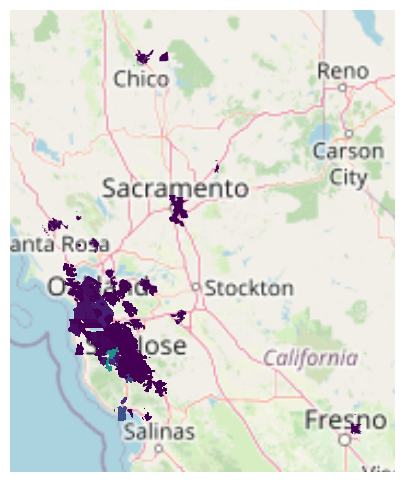

In [6]:
joined = california.set_index("name").merge(noise_df.set_index("Community"), left_index=True, right_index=True)
ax = gplt.webmap(california, projection=gcrs.WebMercator())
# gplt.polyplot(california, projection=gcrs.AlbersEqualArea(), edgecolor='darkgrey', facecolor='lightgrey', linewidth=.3, ax=ax)
gplt.choropleth(joined, projection=gcrs.WebMercator(), hue="Total Complaints", ax=ax)

# Awful tries to get to an interactive map

In [ ]:
# california["geometry"] = (
#     california.to_crs(california.estimate_utm_crs()).simplify(1000).to_crs(california.crs)
# )
#data = california.merge(noise_df, left_on="name", right_on="Community")#.sample(n=15, random_state=1)

# dataframes = [dict(type="cloropeth", locations="Community",
#                     featureidkey="properties.name",
#                     zoom=8.2,
#                     center=dict(lat=37.766801,lon=-122.176573),
#                     opacity=0.5,
#                     mapbox_style="open-street-map") for k, frame in data.groupby("period")]
data = noise_df.query('Community in @communities_with_geodata_df["Community"]')
fig = px.choropleth_mapbox(data,
                    geojson=useful_cities_geof,
                    color="Total Complaints",
                    opacity=0.5,
                    #animation_frame="period",
                    locations="Community",
                    featureidkey="properties.name",
                    zoom=7.5,
                    center={"lat": 37.766801, "lon": -122.176573},
                  mapbox_style="open-street-map")
#fig["layout"].pop("updatemenus")
# steps = []
# for i in range(15):
#     step = dict(method='restyle',
#                 args=['visible', [False] * 15],
#                 label='Year {}'.format(i + 1980))
#     step['args'][1][i] = True
#     steps.append(step)
  
# slider = [dict(active=0,
#                 pad={"t": 1},
#                 steps=steps)] 
# fig = dict(data=dataframes, layout=dict(sliders=slider))
# fig.update_layout(
#     sliders=slider
# )
plotly.offline.iplot(fig)
#data.groupby("period")
#dataframes[0]

# Random sampled interactive map
If I find an interesting timeframe later on, I can specify that period range instead of random sample

In [10]:
selected_periods = periods_df.sample(n=3, random_state=1)["period"]
data = noise_df.query('Community in @communities_with_geodata_df["Community"] & period in @selected_periods')
fig = px.choropleth_mapbox(data,
                    geojson=useful_cities_geof,
                    color="Total Complaints",
                    range_color=[0, data.get("Total Complaints").max()],
                    opacity=0.5,
                    animation_frame="period",
                    locations="Community",
                    featureidkey="properties.name",
                    zoom=7.5,
                    center={"lat": 37.766801, "lon": -122.176573},
                  mapbox_style="open-street-map")
plotly.offline.iplot(fig)